In [24]:
!pip install ultralytics
from ultralytics import YOLO
model = YOLO("yolo11s.pt")


[notice] A new release of pip is available: 25.0 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [25]:
import yaml
with open('C:/Users/edakd/yoloV11/dataset/dataset.yaml' , 'r') as f:
    data=yaml.safe_load(f)
    print(data['names'])

{0: 'Lane'}


In [26]:
class_names=['Lane']

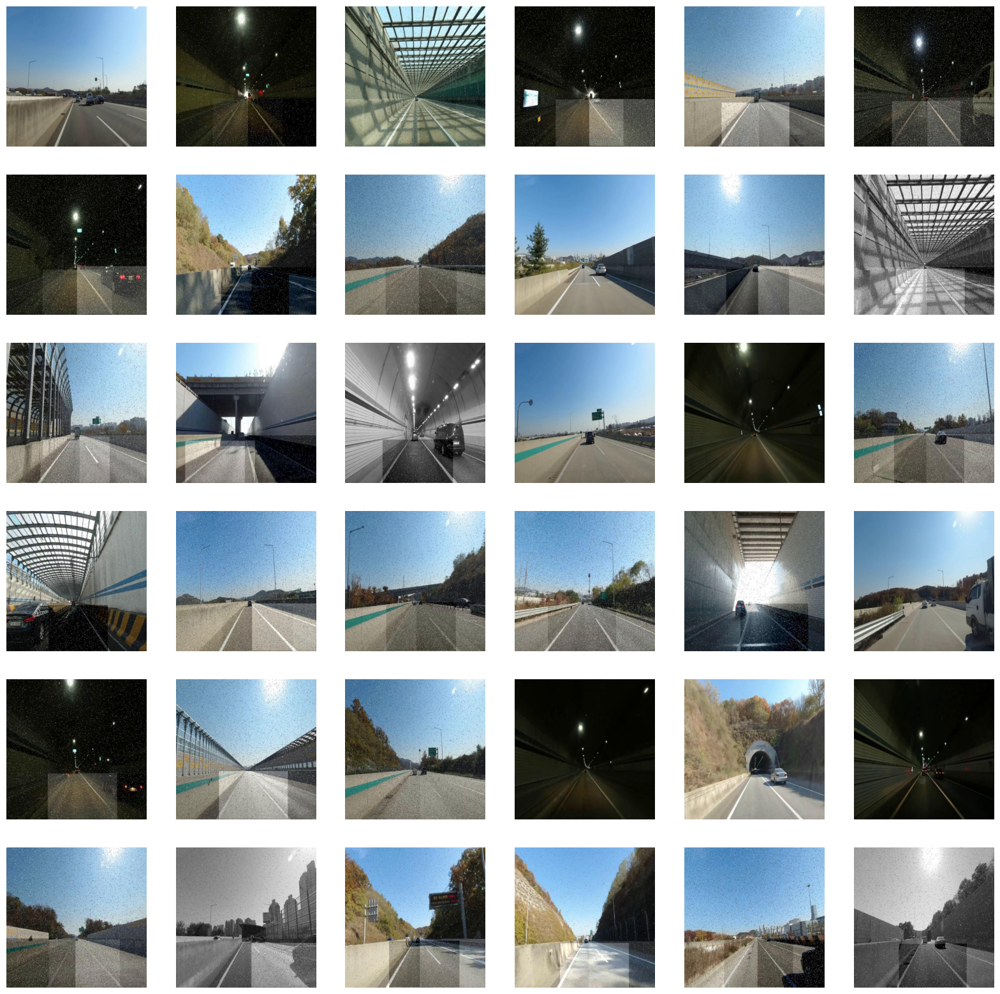

In [27]:
import random
import cv2
import os
import matplotlib.pyplot as plt

image_dir = 'C:/Users/edakd/yoloV11/dataset/train/images'
image_files = os.listdir(image_dir)
random_images = random.sample(image_files, 36)
label_files = 'C:/Users/edakd/yoloV11/dataset/train/labels'

fig, axs = plt.subplots(6, 6, figsize=(20, 20))

for i, image_file in enumerate(random_images):
    image_path = os.path.join(image_dir, image_file)
    image = cv2.imread(image_path)
    label_file = os.path.splitext(image_file)[0] + ".txt"
    label_path = os.path.join(label_files, label_file)
    
    with open(label_path, "r") as f:
        labels = f.read().strip().split("\n")

    for label in labels:
        if len(label.split()) != 5:
            continue
        class_id, x_center, y_center, width, height = map(float, label.split())
        x_min = int((x_center - width / 2) * image.shape[1])
        y_min = int((y_center - height / 2) * image.shape[0])
        x_max = int((x_center + width / 2) * image.shape[1])
        y_max = int((y_center + height / 2) * image.shape[0])

        cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 3)

        text_scale = max(1.5, min(image.shape[1], image.shape[0]) / 700)
        text_thickness = max(1, int(text_scale * 4))
        classe = class_names[int(class_id)]
        cv2.putText(
            image,
            classe,
            (x_min, max(y_min - 10, 0)),
            cv2.FONT_HERSHEY_SIMPLEX,
            text_scale,
            (0, 0, 255),
            text_thickness,
            cv2.LINE_AA,
        )
    row = i // 6 
    col = i % 6  

    axs[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axs[row, col].axis('off')

plt.subplots_adjust(wspace=0.2, hspace=0.2)
plt.show()

In [28]:
with open('C:/Users/edakd/yoloV11/dataset/dataset.yaml','r') as f:
    print(yaml.safe_load(f))

{'train': '/kaggle/working/dataset/train/images', 'val': '/kaggle/working/dataset/val/images', 'test': '/kaggle/working/dataset/test/images', 'nc': 1, 'names': {0: 'Lane'}}


In [29]:
import yaml
data = {
    'train': 'C:/Users/edakd/yoloV11/dataset/train/images',
    'val': 'C:/Users/edakd/yoloV11/dataset/val/images',
    'test': 'C:/Users/edakd/yoloV11/dataset/test/images',
    'nc': 1,
    'names': {0: 'Lane'}
}
with open('dataset_config.yaml', 'w') as file:
    yaml.dump(data, file, default_flow_style=False)

print("YAML file 'dataset_config.yaml' created successfully.")

YAML file 'dataset_config.yaml' created successfully.


In [33]:
model=YOLO('yolo11s.pt')
model.train(data=r'C:\Users\edakd\yoloV11\dataset\dataset.yaml',epochs=20,batch=16,imgsz=640)

New https://pypi.org/project/ultralytics/8.3.78 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.51  Python-3.9.13 torch-2.6.0+cpu CPU (11th Gen Intel Core(TM) i7-11800H 2.30GHz)
engine\trainer: task=detect, mode=train, model=yolo11s.pt, data=C:\Users\edakd\yoloV11\dataset\dataset.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train7, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, emb

RuntimeError: Dataset 'C://Users/edakd/yoloV11/dataset/dataset.yaml' error  
Dataset 'C://Users/edakd/yoloV11/dataset/dataset.yaml' images not found , missing path 'C:\kaggle\working\dataset\val\images'
Note dataset download directory is 'C:\Users\edakd\Untitled Folder\datasets'. You can update this in 'C:\Users\edakd\AppData\Roaming\Ultralytics\settings.json'

In [ ]:
import os
from IPython.display import Image, display
path = '/kaggle/working/runs/detect/train3'

images = [f for f in os.listdir(path) if f.endswith(('.jpg', '.jpeg', '.png'))]

for i in images:
    display(Image(filename=os.path.join(path, i)))

In [31]:
metrics = model.val(split='val')

print(f"Mean Average Precision @.5:.95 : {metrics.box.map}")    
print(f"Mean Average Precision @ .50   : {metrics.box.map50}") 
print(f"Mean Average Precision @ .70   : {metrics.box.map75}")
print("recall : ",metrics.box.r)
print(metrics.box.f1)
print(metrics.box.maps)

Ultralytics 8.3.51  Python-3.9.13 torch-2.6.0+cpu CPU (11th Gen Intel Core(TM) i7-11800H 2.30GHz)
YOLO11s summary (fused): 238 layers, 9,443,760 parameters, 0 gradients, 21.5 GFLOPs


FileNotFoundError: '/usr/src/ultralytics/ultralytics/cfg/datasets/coco.yaml' does not exist


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i101.jpg: 640x640 3 cars, 159.9ms
Speed: 5.7ms preprocess, 159.9ms inference, 10.2ms postprocess per image at shape (1, 3, 640, 640)


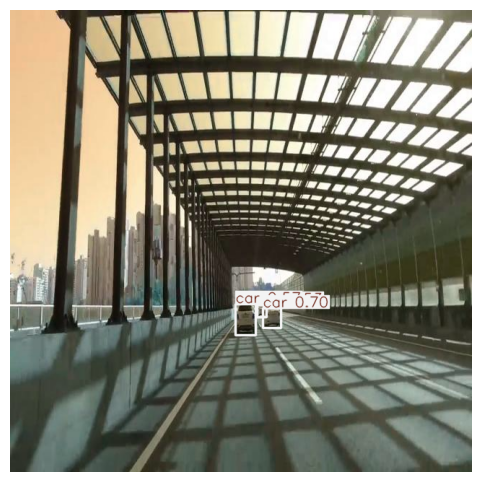


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i1013.jpg: 640x640 (no detections), 122.0ms
Speed: 3.0ms preprocess, 122.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


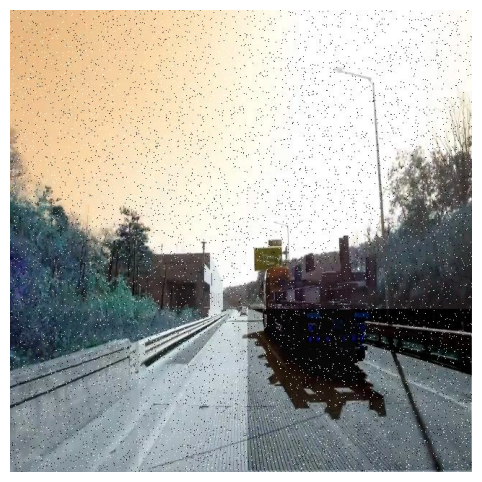


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i1014.jpg: 640x640 1 train, 115.0ms
Speed: 2.9ms preprocess, 115.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


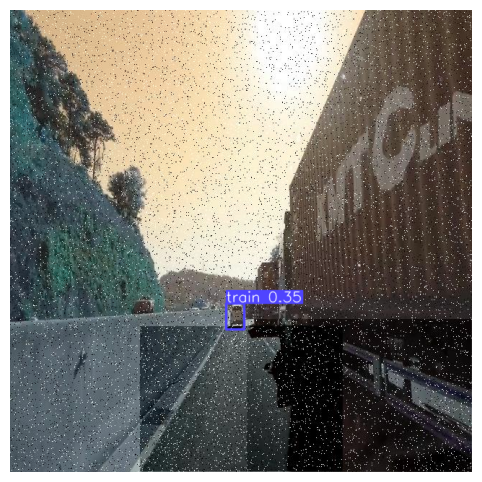


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i148.jpg: 640x640 (no detections), 113.0ms
Speed: 4.0ms preprocess, 113.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


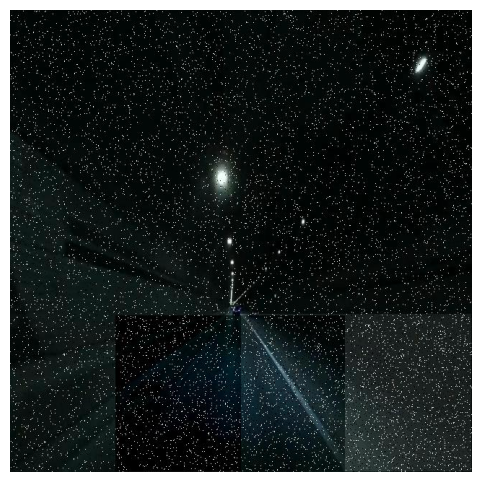


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i151.jpg: 640x640 1 car, 121.0ms
Speed: 3.0ms preprocess, 121.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


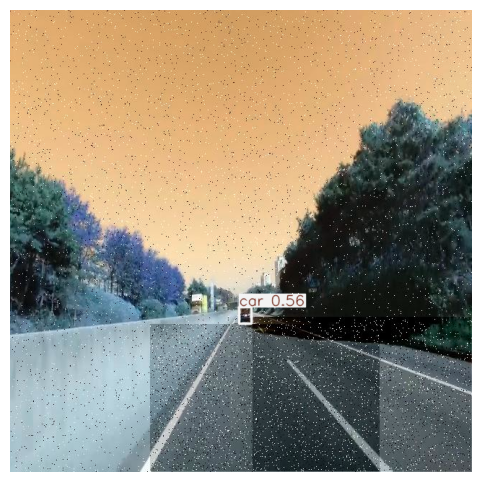


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i153.jpg: 640x640 (no detections), 116.1ms
Speed: 2.0ms preprocess, 116.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


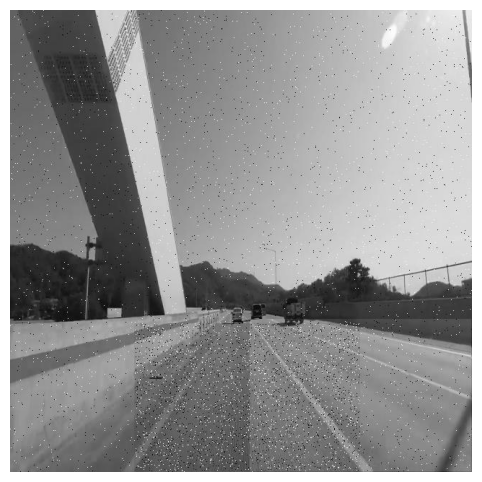


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i170.jpg: 640x640 3 cars, 124.0ms
Speed: 2.0ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


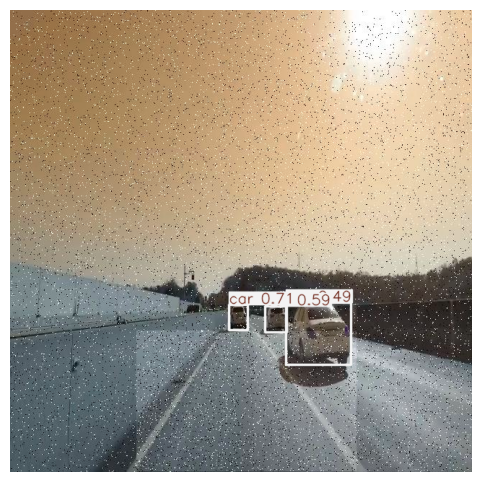


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i172.jpg: 640x640 5 cars, 1 truck, 126.1ms
Speed: 3.0ms preprocess, 126.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


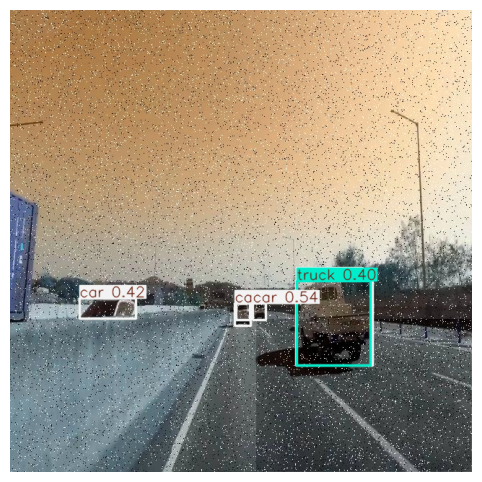


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i188.jpg: 640x640 (no detections), 126.0ms
Speed: 4.0ms preprocess, 126.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


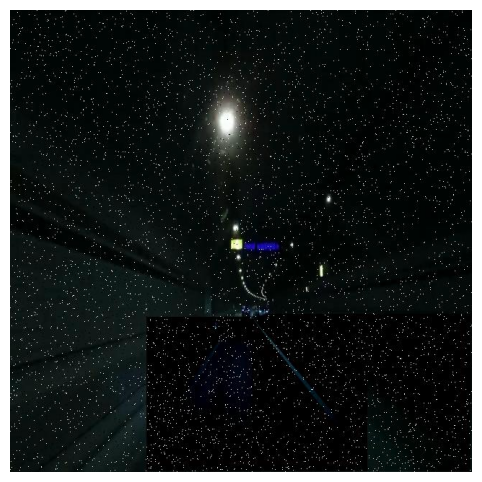


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i198.jpg: 640x640 (no detections), 113.0ms
Speed: 3.0ms preprocess, 113.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


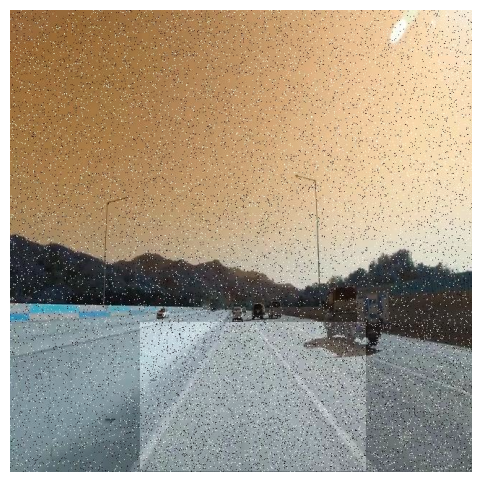


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i199.jpg: 640x640 2 cars, 118.0ms
Speed: 3.0ms preprocess, 118.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


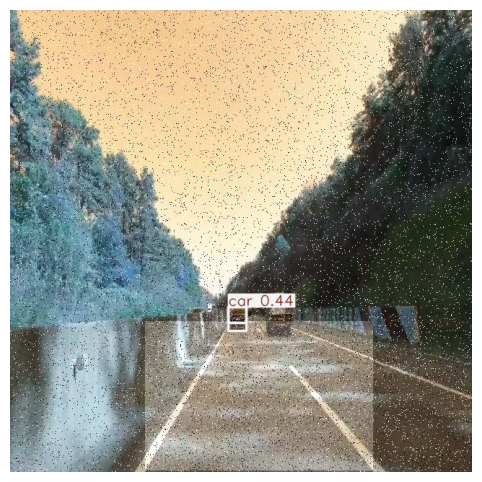


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i207.jpg: 640x640 (no detections), 135.0ms
Speed: 4.0ms preprocess, 135.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


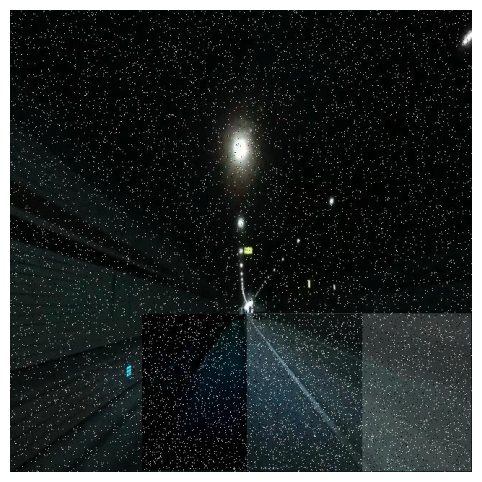


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i220.jpg: 640x640 3 cars, 113.1ms
Speed: 3.0ms preprocess, 113.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


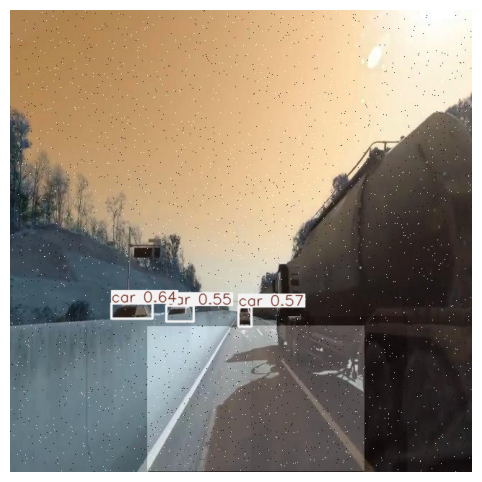


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i231.jpg: 640x640 (no detections), 112.0ms
Speed: 2.0ms preprocess, 112.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


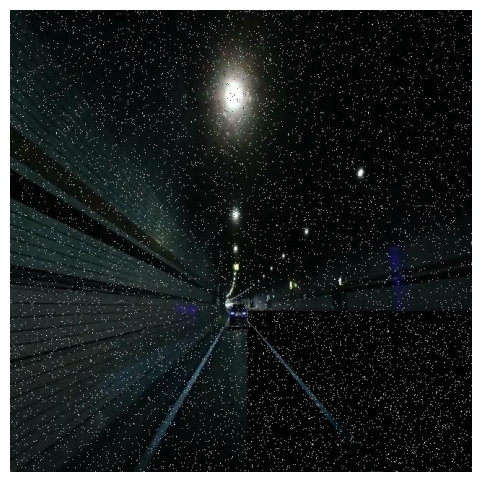


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i234.jpg: 640x640 (no detections), 122.0ms
Speed: 2.0ms preprocess, 122.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


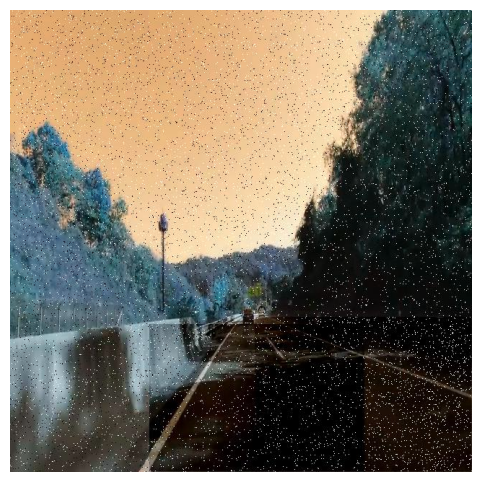


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i254.jpg: 640x640 1 traffic light, 119.1ms
Speed: 5.0ms preprocess, 119.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


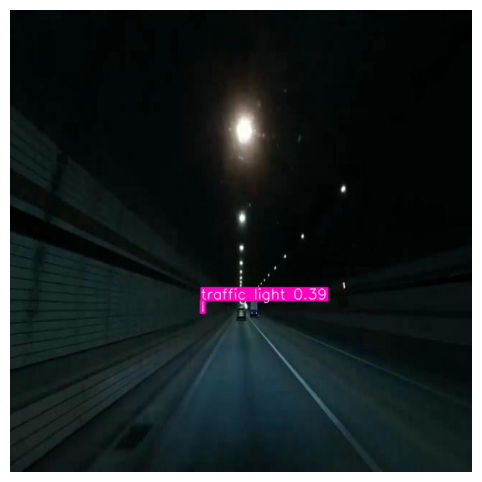


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i262.jpg: 640x640 2 cars, 123.0ms
Speed: 4.0ms preprocess, 123.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


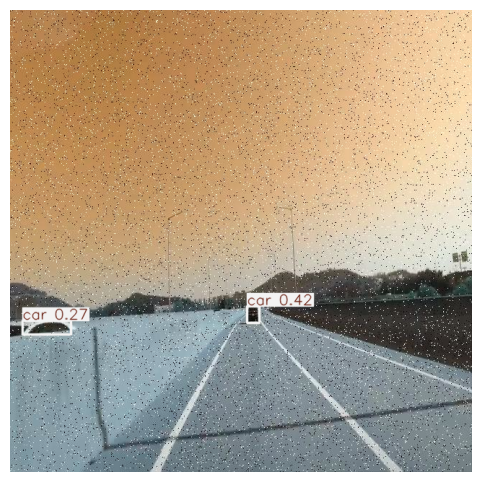


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i265.jpg: 640x640 1 tv, 125.0ms
Speed: 3.0ms preprocess, 125.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


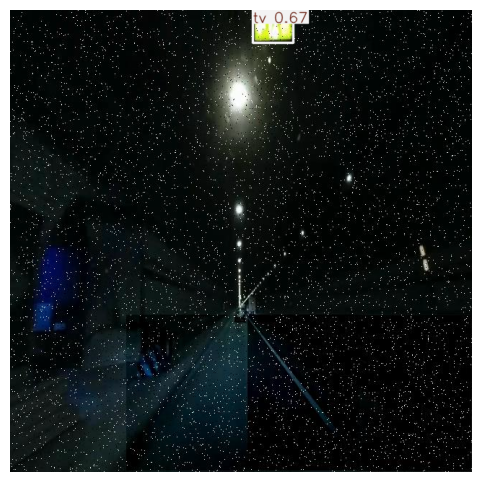


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i266.jpg: 640x640 (no detections), 120.0ms
Speed: 4.0ms preprocess, 120.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


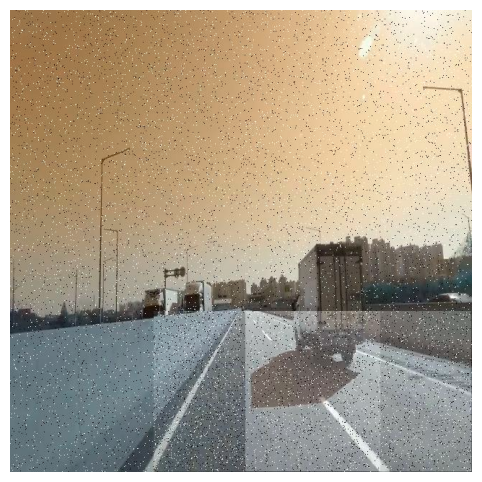


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i269.jpg: 640x640 2 cars, 115.0ms
Speed: 3.0ms preprocess, 115.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


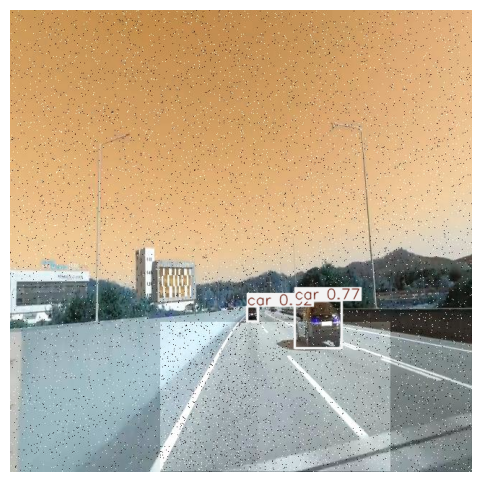


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i272.jpg: 640x640 (no detections), 122.0ms
Speed: 3.0ms preprocess, 122.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


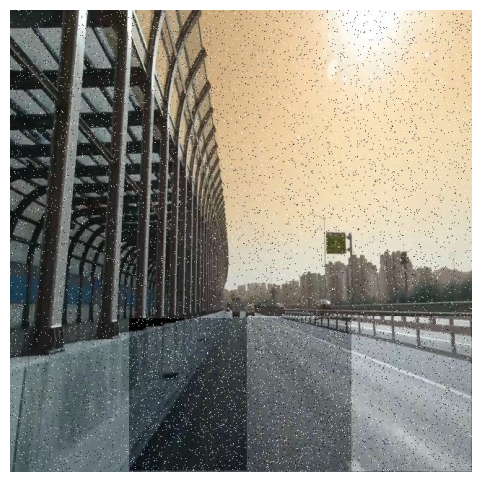


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i274.jpg: 640x640 1 train, 121.0ms
Speed: 3.0ms preprocess, 121.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


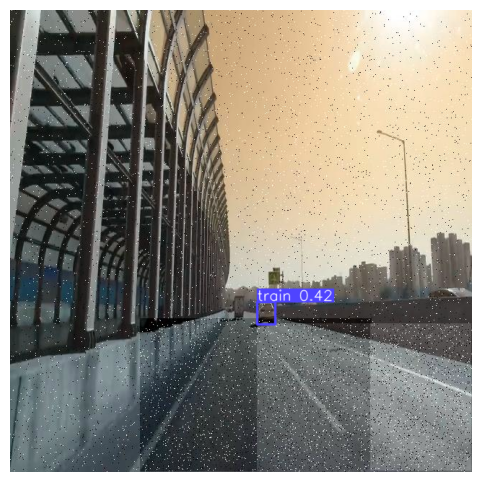


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i306.jpg: 640x640 (no detections), 114.1ms
Speed: 3.0ms preprocess, 114.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


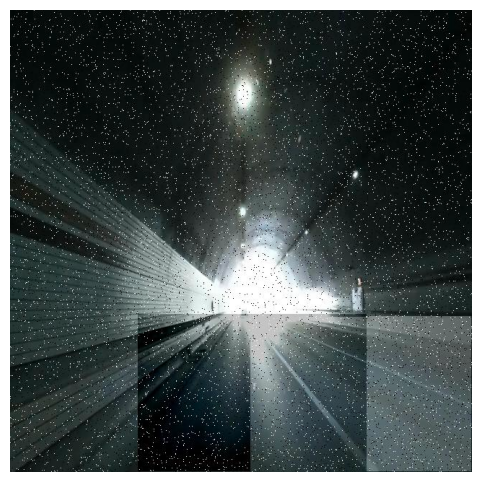


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i310.jpg: 640x640 1 train, 1 truck, 116.1ms
Speed: 3.9ms preprocess, 116.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


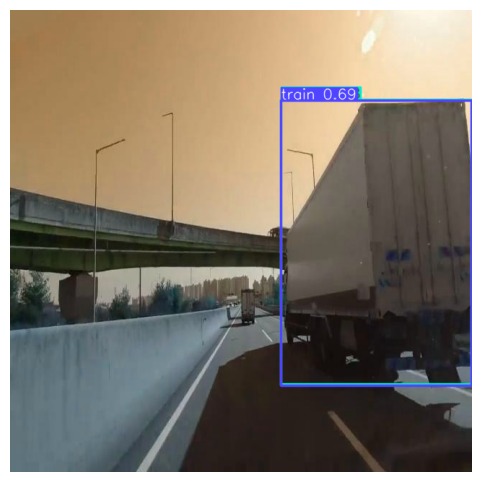


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i329.jpg: 640x640 1 car, 138.9ms
Speed: 2.0ms preprocess, 138.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


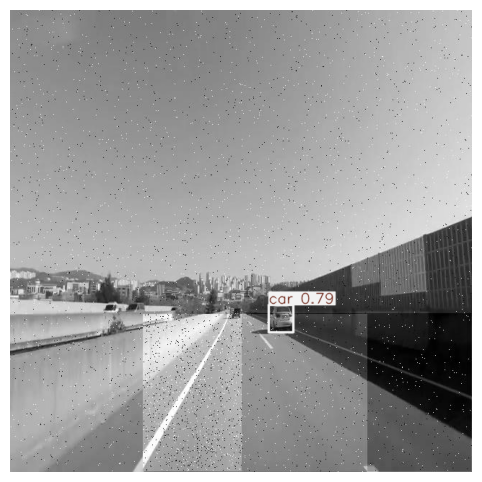


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i373.jpg: 640x640 1 car, 122.0ms
Speed: 3.0ms preprocess, 122.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


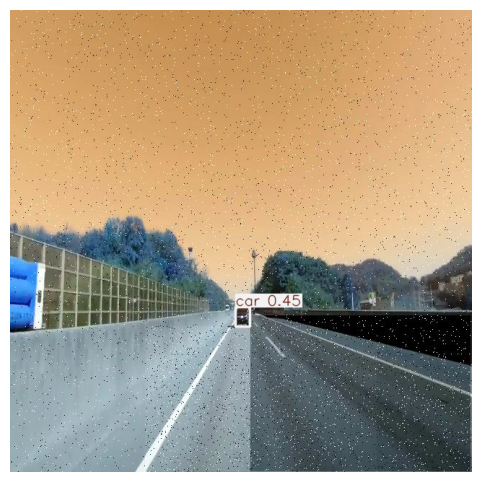


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i376.jpg: 640x640 (no detections), 140.5ms
Speed: 4.0ms preprocess, 140.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


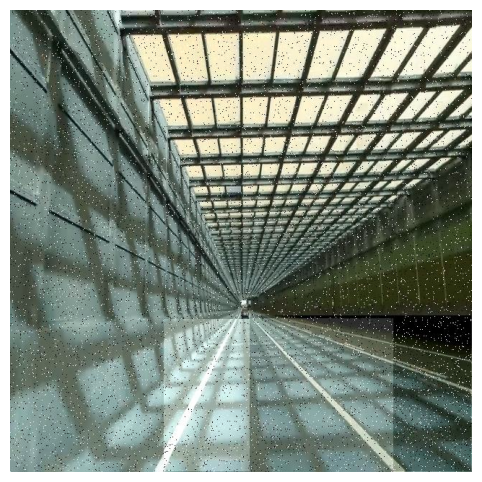


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i38.jpg: 640x640 (no detections), 137.8ms
Speed: 3.0ms preprocess, 137.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


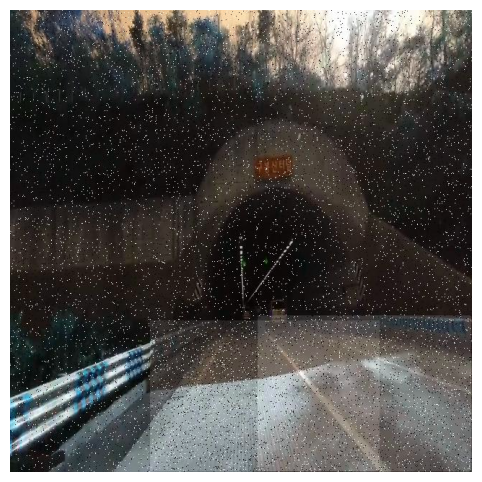


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i384.jpg: 640x640 2 cars, 124.0ms
Speed: 4.5ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


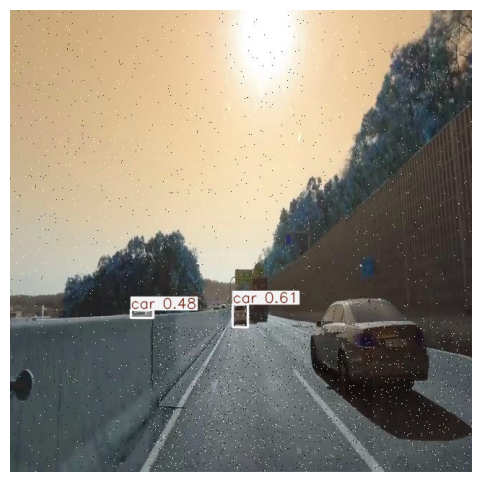


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i398.jpg: 640x640 (no detections), 126.0ms
Speed: 4.0ms preprocess, 126.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


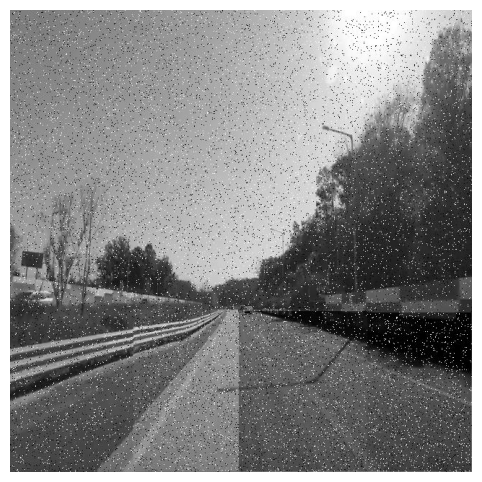


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i399.jpg: 640x640 (no detections), 117.0ms
Speed: 4.0ms preprocess, 117.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


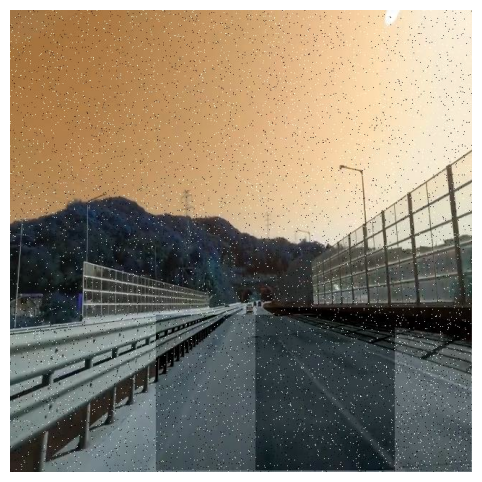


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i43.jpg: 640x640 3 cars, 124.0ms
Speed: 4.0ms preprocess, 124.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


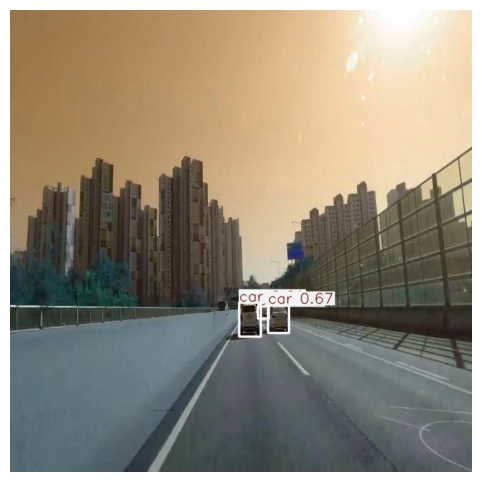


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i454.jpg: 640x640 1 truck, 121.0ms
Speed: 2.0ms preprocess, 121.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


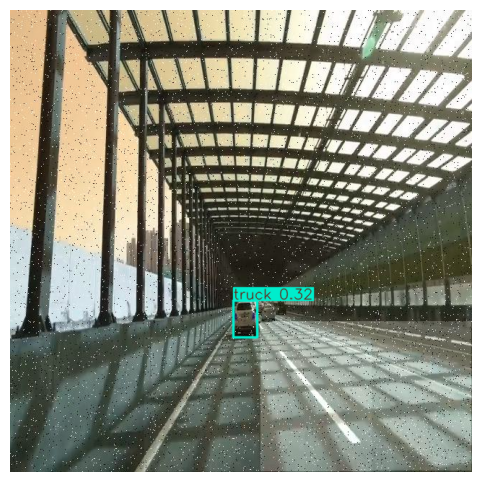


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i460.jpg: 640x640 (no detections), 118.0ms
Speed: 3.0ms preprocess, 118.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


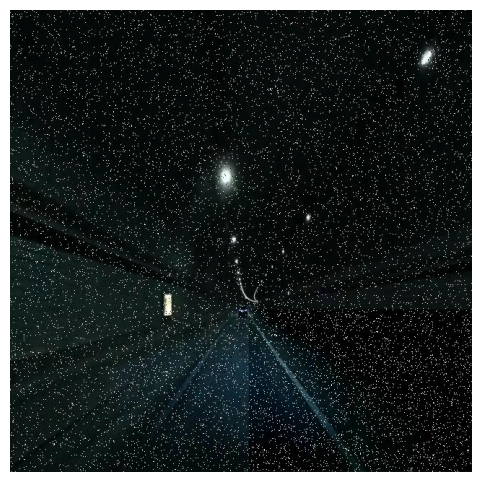


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i463.jpg: 640x640 (no detections), 124.0ms
Speed: 3.0ms preprocess, 124.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


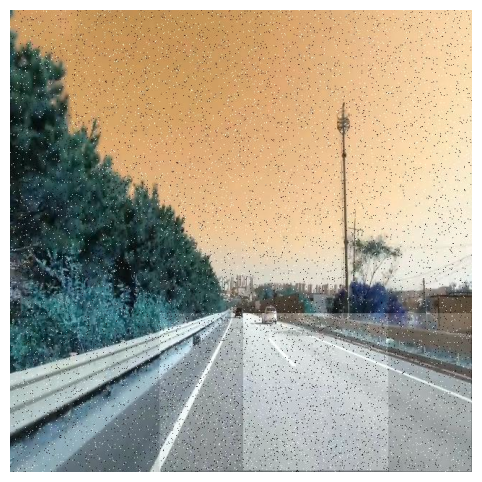


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i467.jpg: 640x640 1 car, 117.0ms
Speed: 4.0ms preprocess, 117.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


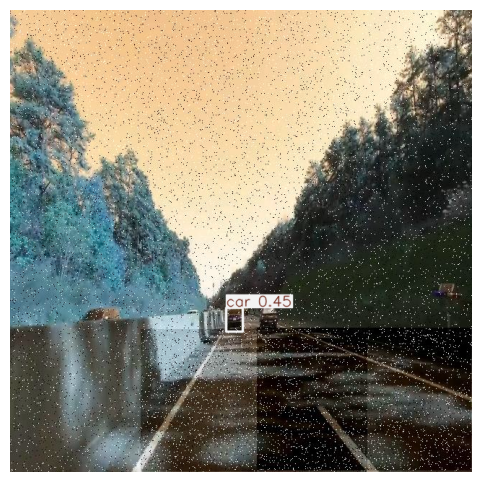


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i473.jpg: 640x640 1 car, 1 train, 1 umbrella, 119.0ms
Speed: 3.0ms preprocess, 119.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


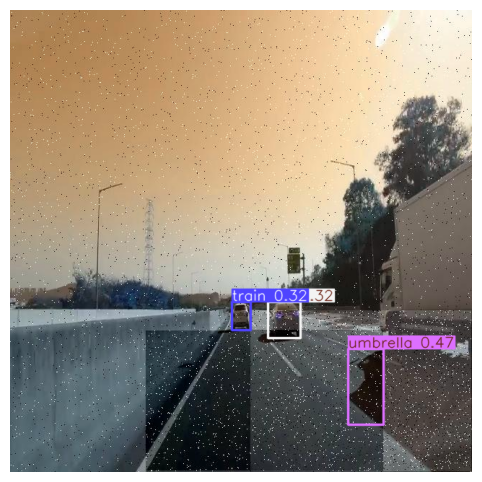


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i479.jpg: 640x640 (no detections), 139.0ms
Speed: 3.0ms preprocess, 139.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


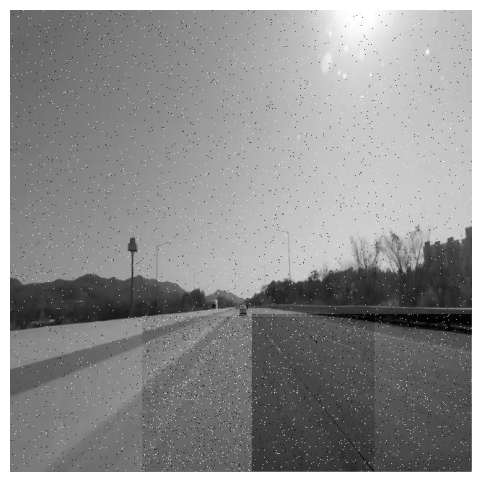


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i48.jpg: 640x640 1 person, 135.0ms
Speed: 3.0ms preprocess, 135.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


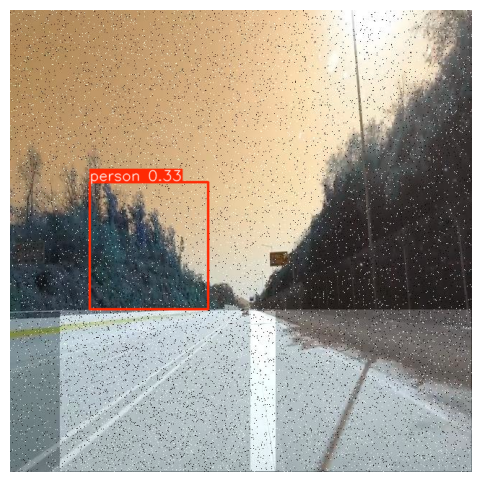


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i499.jpg: 640x640 1 train, 136.0ms
Speed: 3.0ms preprocess, 136.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


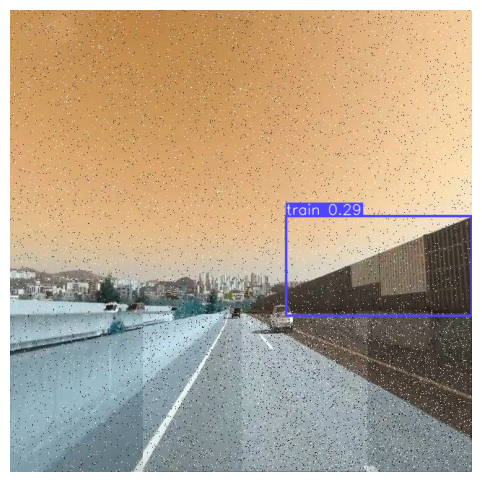


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i503.jpg: 640x640 (no detections), 125.0ms
Speed: 2.0ms preprocess, 125.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


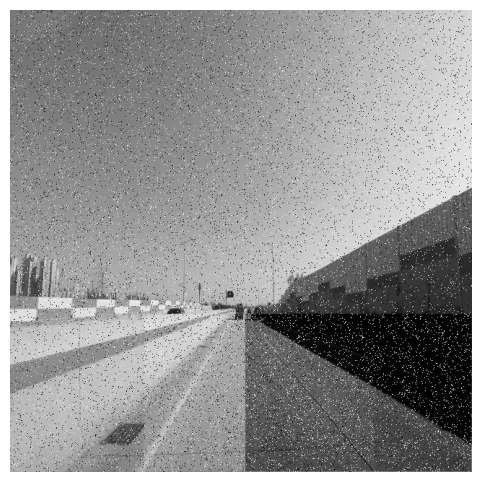


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i508.jpg: 640x640 4 cars, 2 traffic lights, 145.1ms
Speed: 4.2ms preprocess, 145.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


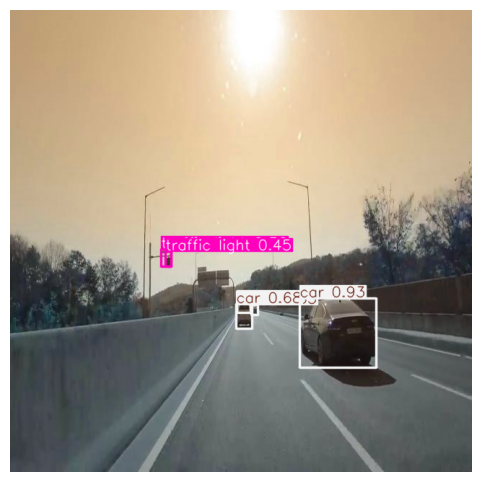


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i512.jpg: 640x640 (no detections), 115.0ms
Speed: 2.0ms preprocess, 115.0ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


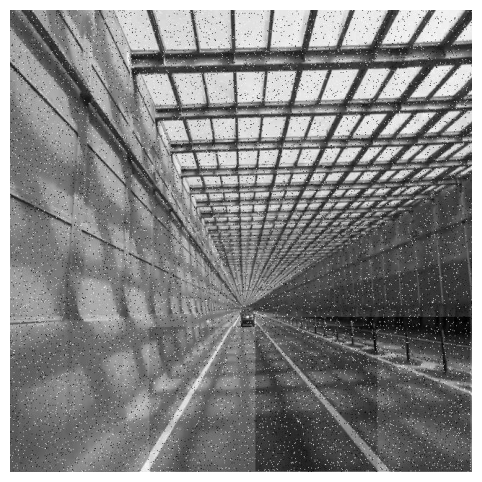


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i513.jpg: 640x640 3 cars, 124.5ms
Speed: 3.0ms preprocess, 124.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


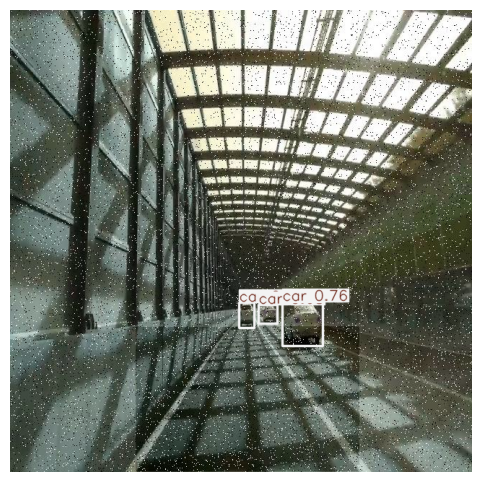


image 1/1 C:\Users\edakd\yoloV11\dataset\test\images\i517.jpg: 640x640 (no detections), 128.1ms
Speed: 4.0ms preprocess, 128.1ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


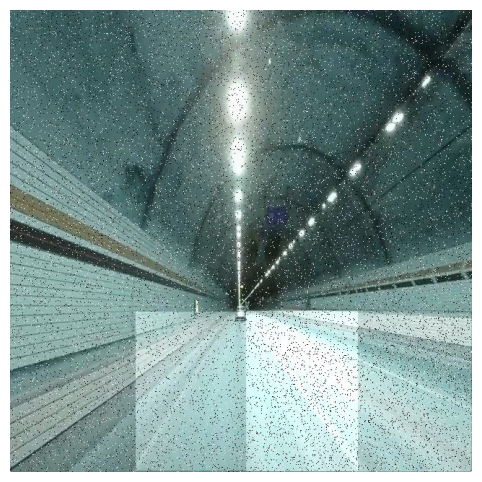

In [32]:
image_dir='C:/Users/edakd/yoloV11/dataset/test/images'
all_images = os.listdir(image_dir)
selected_images = all_images[:45]

for img_name in selected_images:
    img_path = os.path.join(image_dir, img_name) 
    results = model.predict(img_path)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  
    for result in results:
        plotted_img = result.plot()
        plt.figure(figsize=(8, 6))  
        plt.imshow(plotted_img)    
        plt.axis('off')             
        plt.show() 